In [1]:
%matplotlib inline
import os, sys
import time
import json
sys.path.insert(0, '/usr/local/opencv-2.4.13/lib/python2.7/site-packages/')
import cv2
print cv2.__version__

import numpy as np
from skimage import io, transform
from skimage.draw import polygon, polygon_perimeter

import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (20.0, 7.0)


2.4.13


In [2]:
import math
def rbox_2_polygon(xc, yc, w, h, rad):
    w2 = w/2
    h2 = h/2
    m_rot = np.array([[np.cos(rad), -np.sin(rad)], 
                      [np.sin(rad), np.cos(rad)]], dtype=np.float32)
    pts_ = np.array([[-w2,-h2],
                     [w2,-h2],
                     [w2,h2],
                     [-w2,h2]], dtype=np.float32)
    pts = np.dot(m_rot, pts_.T).T
    pts[:,0] = pts[:,0] + xc
    pts[:,1] = pts[:,1] + yc
    return pts.flatten().tolist()


def polygon_2_rbox(poly):
    x1, y1, x2, y2, x3, y3, x4, y4 = poly
    theta = math.atan2(y2-y1, x2-x1)
    pts = np.array([[x1, y1], [x2, y2], [x3, y3], [x4, y4]], dtype=np.float32)
    pts[:, 0] = pts[:, 0] - x1
    pts[:, 1] = pts[:, 1] - y1
    m_rot = np.array([[np.cos(theta), np.sin(theta)],
                      [-np.sin(theta), np.cos(theta)]], dtype=np.float32)
    pts_ = np.dot(m_rot, pts.T)
    w = np.amax(pts_[0,:]) - np.amin(pts_[0,:])
    h = np.amax(pts_[1,:]) - np.amin(pts_[1,:])
    xc_ = (np.amax(pts_[0,:]) + np.amin(pts_[0,:]))/2
    yc_ = (np.amax(pts_[1,:]) + np.amin(pts_[1,:]))/2
    xc = x1 + xc_ * np.cos(theta) - yc_ * np.sin(theta)
    yc = y1 + xc_ * np.sin(theta) + yc_ * np.cos(theta)
    return xc, yc, w, h, theta


def shrink_quadrangle(poly, t=0.3):
    x1, y1, x2, y2, x3, y3, x4, y4 = poly
    
    d1 = max(2, math.sqrt((x2 - x1) * (x2 - x1) + (y2 - y1) * (y2 - y1)))
    d2 = max(2, math.sqrt((x3 - x2) * (x3 - x2) + (y3 - y2) * (y3 - y2)))
    d3 = max(2, math.sqrt((x4 - x3) * (x4 - x3) + (y4 - y3) * (y4 - y3)))
    d4 = max(2, math.sqrt((x1 - x4) * (x1 - x4) + (y1 - y4) * (y1 - y4)))
    print(poly, d1,d2,d3,d4)
    min_d = min([d1, d2, d3, d4])

    x1_ = x1 + t * (x2 - x1) * min_d / d1
    y1_ = y1 + t * (y2 - y1) * min_d / d1
    x2_ = x2 + t * (x1 - x2) * min_d / d1
    y2_ = y2 + t * (y1 - y2) * min_d / d1
    x3_ = x3 + t * (x4 - x3) * min_d / d3
    y3_ = y3 + t * (y4 - y4) * min_d / d3
    x4_ = x4 + t * (x3 - x4) * min_d / d3
    y4_ = y4 + t * (y3 - y4) * min_d / d3
    x1, y1, x2, y2, x3, y3, x4, y4 = x1_, y1_, x2_, y2_, x3_, y3_, x4_, y4_

    x1_ = x1 + t * (x4 - x1) * min_d / d4
    y1_ = y1 + t * (y4 - y1) * min_d / d4
    x4_ = x4 + t * (x1 - x4) * min_d / d4
    y4_ = y4 + t * (y1 - y4) * min_d / d4
    x2_ = x2 + t * (x3 - x2) * min_d / d2
    y2_ = y2 + t * (y3 - y2) * min_d / d2
    x3_ = x3 + t * (x2 - x3) * min_d / d2
    y3_ = y3 + t * (y2 - y3) * min_d / d2

    return [x1_, y1_, x2_, y2_, x3_, y3_, x4_, y4_]

In [3]:
def show_polygons(im, polygons):
    assert polygons.shape[1] == 8
    for p in polygons:
        rr, cc = polygon(p[1::2], p[0::2])
        rr = np.clip(rr, 0, im.shape[0]-1)
        cc = np.clip(cc, 0, im.shape[1]-1)
        alpha = 0.5 # set alpha of marker
        im[rr, cc, 0] = alpha * 255 + im[rr, cc, 0] * (1 - alpha)
        im[rr, cc, 1] = im[rr, cc, 1] * (1 - alpha)
        im[rr, cc, 2] = im[rr, cc, 2] * (1 - alpha)
        im[p[1]-1:p[1]+2, p[0]-1:p[0]+2] = np.array([0,255,0], dtype=np.uint8) # green for start point
        im[p[3]-1:p[3]+2, p[2]-1:p[2]+2] = np.array([0,0,255], dtype=np.uint8) # blue for end point
    plt.imshow(im);plt.show()


def show_rboxes(im, rboxes):
    assert rboxes.shape[1] == 5
    polygons = []
    for rbox in rboxes:
        polygons.append(rbox_2_polygon(*rbox.tolist()))
    show_polygons(im, np.array(polygons))

# COCO-Text

In [4]:

image_root = '/world/data-c7/censhusheng/data/COCO/images/train2014/'
anno_file = '/world/data-c7/censhusheng/data/COCO-Text/COCO_Text.json'


with open(anno_file) as f:
    anno = json.load(f)


{u'height': 427, u'width': 640, u'set': u'val', u'id': 131315, u'file_name': u'COCO_train2014_000000131315.jpg'}


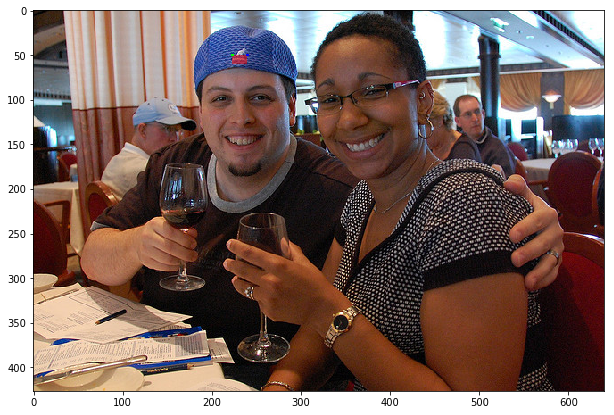

-------
{u'height': 640, u'width': 427, u'set': u'train', u'id': 231049, u'file_name': u'COCO_train2014_000000231049.jpg'}


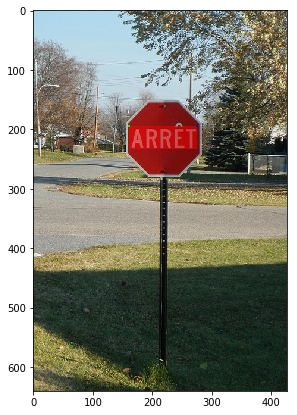

-------
{u'height': 640, u'width': 427, u'set': u'val', u'id': 346812, u'file_name': u'COCO_train2014_000000346812.jpg'}


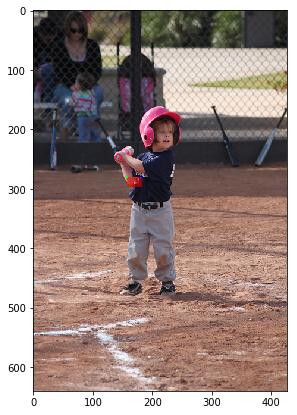

-------
{u'height': 480, u'width': 640, u'set': u'train', u'id': 326594, u'file_name': u'COCO_train2014_000000326594.jpg'}


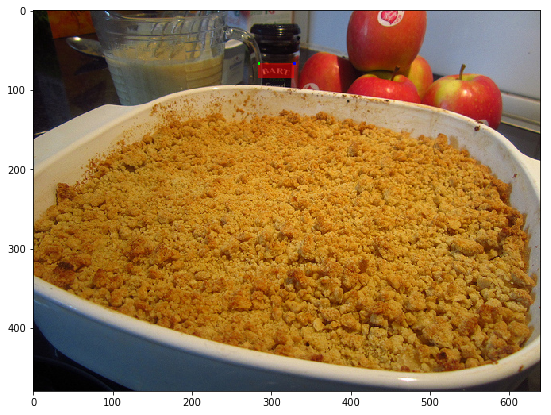

-------
{u'height': 480, u'width': 640, u'set': u'train', u'id': 561849, u'file_name': u'COCO_train2014_000000561849.jpg'}


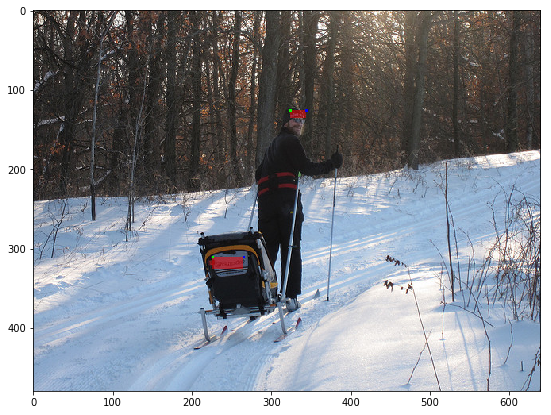

-------
{u'height': 383, u'width': 640, u'set': u'train', u'id': 124117, u'file_name': u'COCO_train2014_000000124117.jpg'}


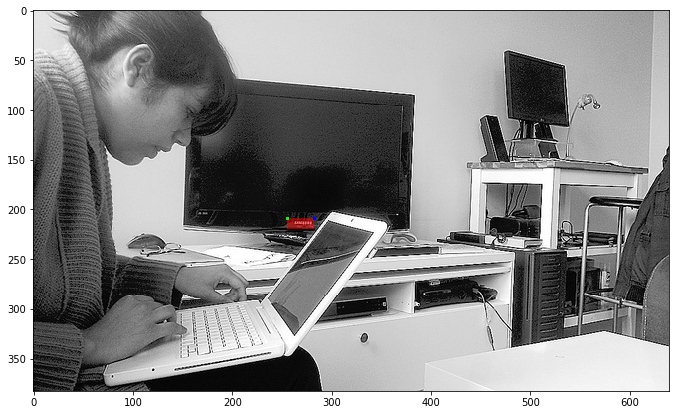

-------
{u'height': 378, u'width': 640, u'set': u'val', u'id': 240129, u'file_name': u'COCO_train2014_000000240129.jpg'}


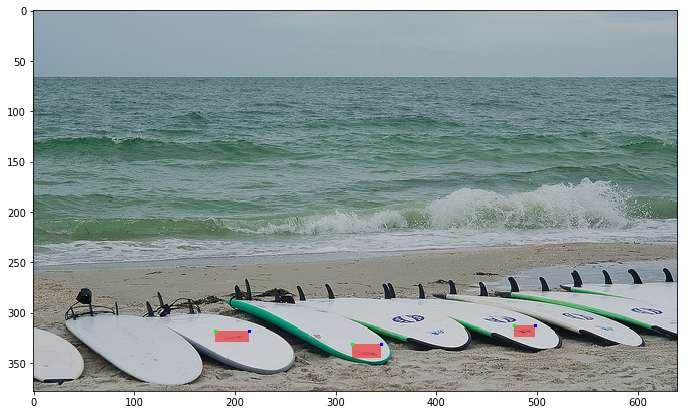

-------
{u'height': 333, u'width': 500, u'set': u'train', u'id': 376843, u'file_name': u'COCO_train2014_000000376843.jpg'}


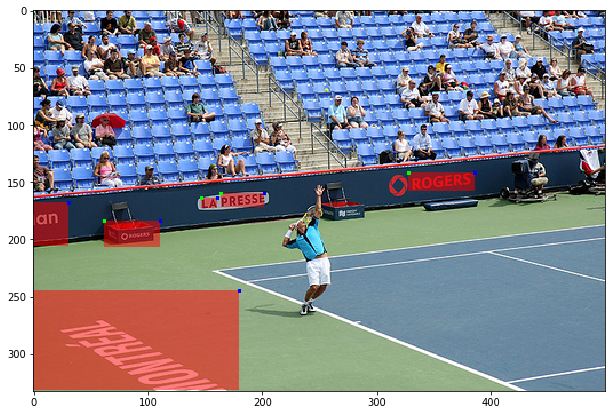

-------
{u'height': 500, u'width': 334, u'set': u'train', u'id': 140850, u'file_name': u'COCO_train2014_000000140850.jpg'}


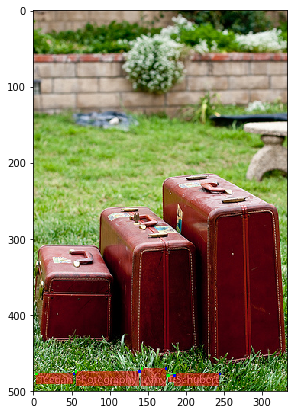

-------
{u'height': 425, u'width': 640, u'set': u'train', u'id': 378865, u'file_name': u'COCO_train2014_000000378865.jpg'}


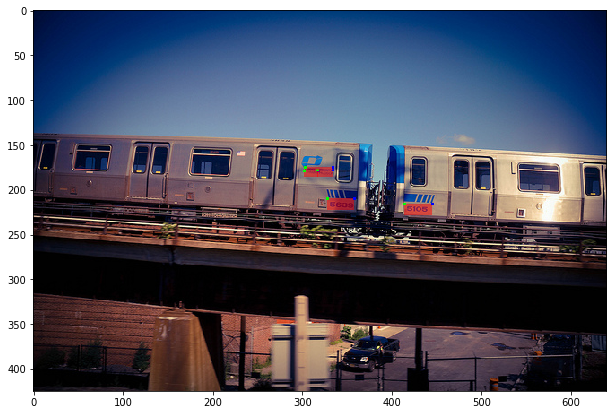

-------
{u'height': 491, u'width': 640, u'set': u'train', u'id': 376848, u'file_name': u'COCO_train2014_000000376848.jpg'}


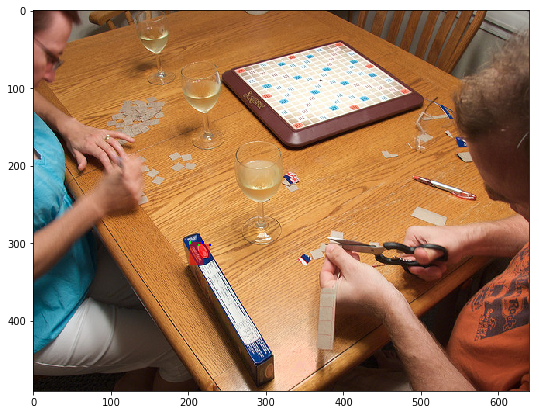

-------
{u'height': 633, u'width': 640, u'set': u'train', u'id': 32607, u'file_name': u'COCO_train2014_000000032607.jpg'}


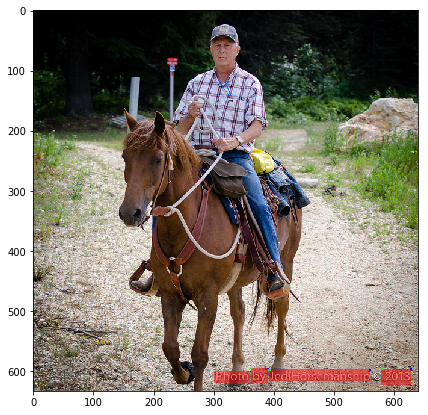

-------


In [5]:
imgs = anno['imgs']
imgToAnns = anno['imgToAnns']
anns = anno['anns']

for img in imgs.values()[600:620]:
    img_id = img['id']
    anns_for_img = imgToAnns[str(img_id)]
    if len(anns_for_img) <1:
        continue
    print img ###
    im = io.imread(os.path.join(image_root, img['file_name']))
    
    p_list = []
    for a in anns_for_img:
        ann = anns[str(a)]
        #print ann ###
        b = np.array(ann['bbox'], dtype=np.int32)
        p = np.array(ann['polygon'], dtype=np.int32)
        p_list.append(p)
    polygons = np.vstack(p_list)
    show_polygons(im, polygons)
    print '-------'

# ICDAR2015-Incidental_Scene_Text

In [6]:
gt_root = '/world/data-c7/censhusheng/data/icdar2015-Incidental_Scene_Text/train_gt/'
img_root = '/world/data-c7/censhusheng/data/icdar2015-Incidental_Scene_Text/train_images/'

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  # This is added back by InteractiveShellApp.init_path()
/usr/lib/python2.7/site-packages/ipykernel_launcher.py:12: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  if sys.path[0] == '':


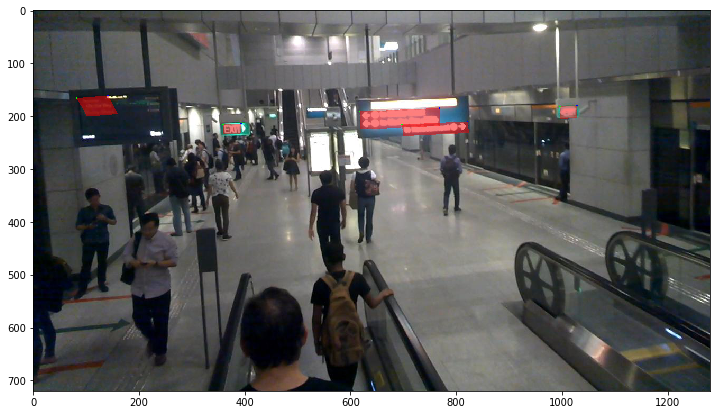

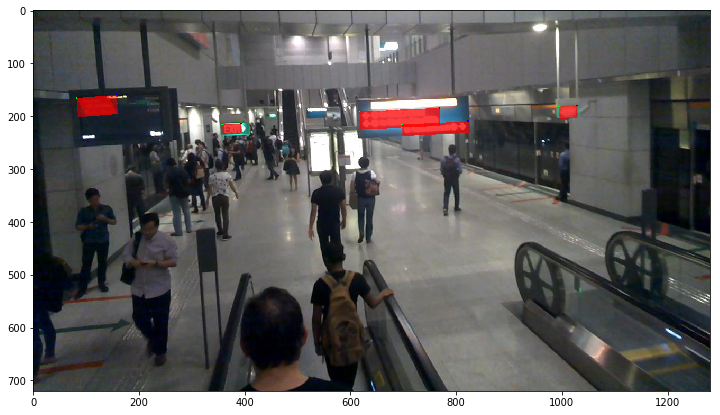

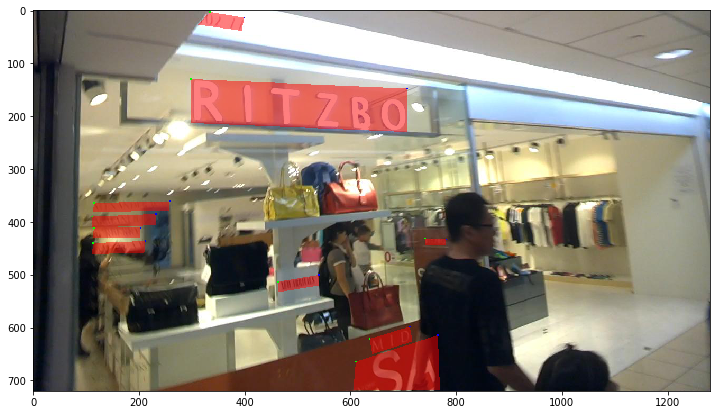

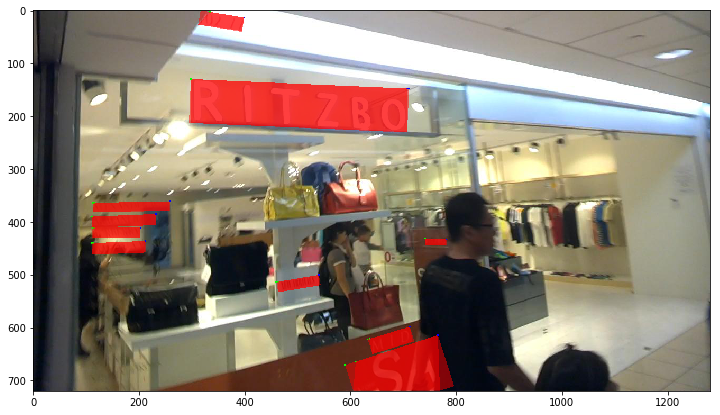

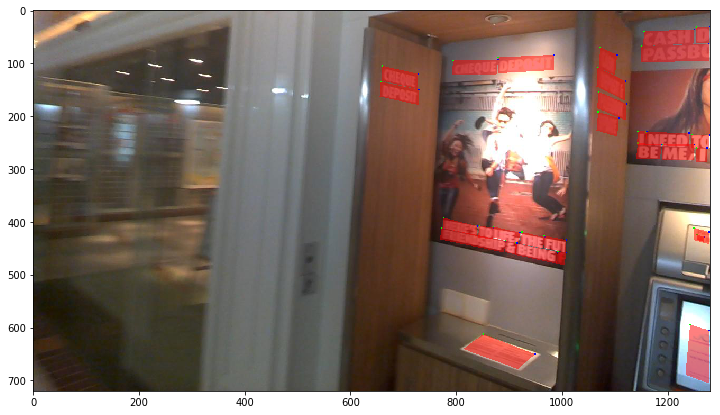

...

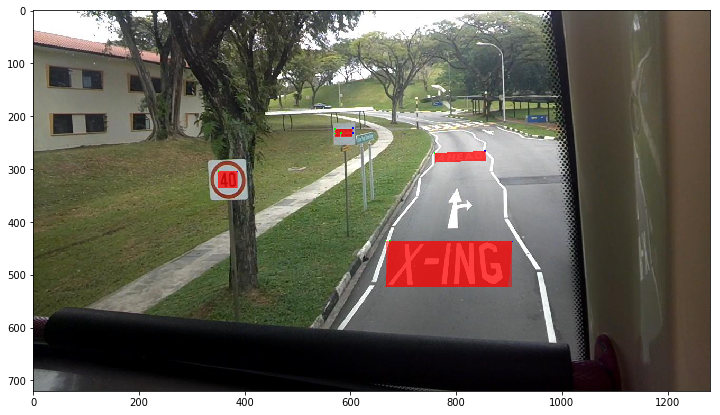

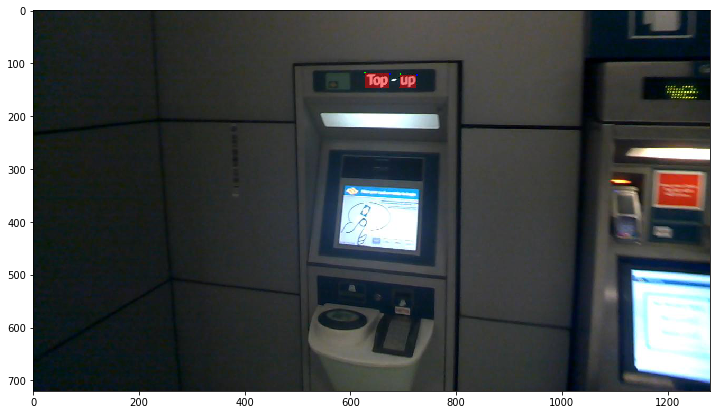

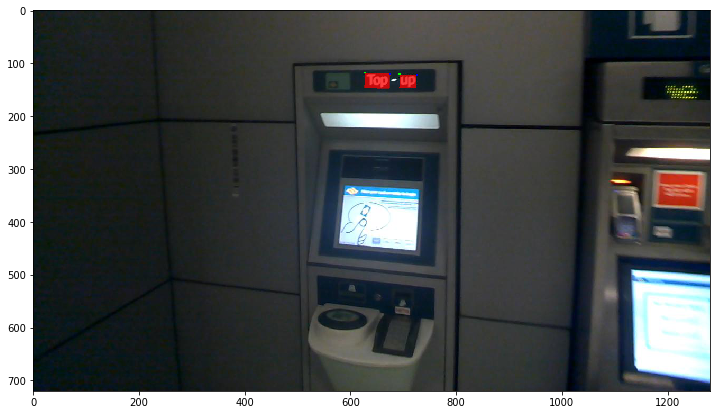

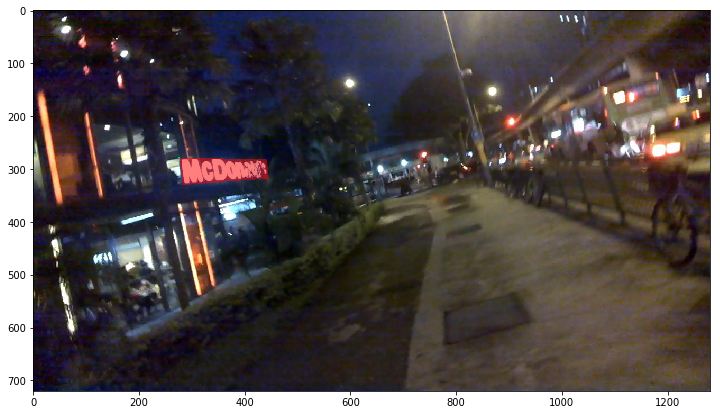

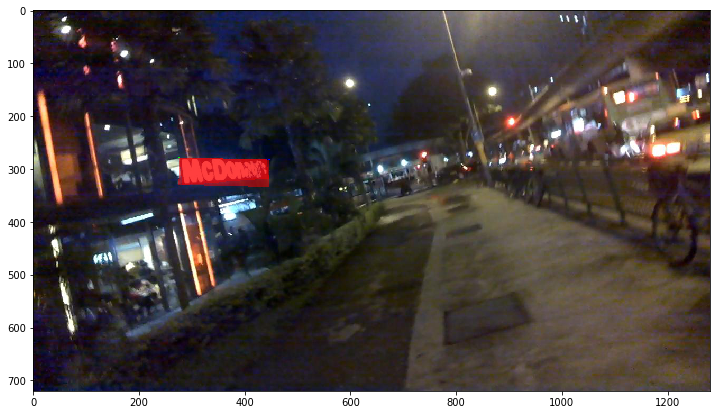

In [7]:
for fn in os.listdir(img_root)[:10]:
    gt_fn = 'gt_' + os.path.splitext(fn)[0] + '.txt'
    p_list = []
    rbox_list = []
    
    with open(os.path.join(gt_root, gt_fn)) as f_gt:
        for line in f_gt.readlines():
            line = line.decode("utf-8-sig").encode("utf-8")
            items = line.strip().split(',')
            p = [int(x) for x in items[:8]]
            rbox = polygon_2_rbox(p)
            
            p_list.append(p)
            rbox_list.append(rbox)

    im = io.imread(os.path.join(img_root, fn))
    show_polygons(im, np.array(p_list, dtype=np.float32))
    show_rboxes(im, np.array(rbox_list, dtype=np.float32))

# ICDAR2013-Focused_Scene_Text

In [8]:
name = 'test'
gt_root = '/world/data-c7/censhusheng/data/icdar2013-Focused_Scene_Text/%s_gt/' % name
img_root = '/world/data-c7/censhusheng/data/icdar2013-Focused_Scene_Text/%s_images/' % name

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  # This is added back by InteractiveShellApp.init_path()
/usr/lib/python2.7/site-packages/ipykernel_launcher.py:12: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  if sys.path[0] == '':


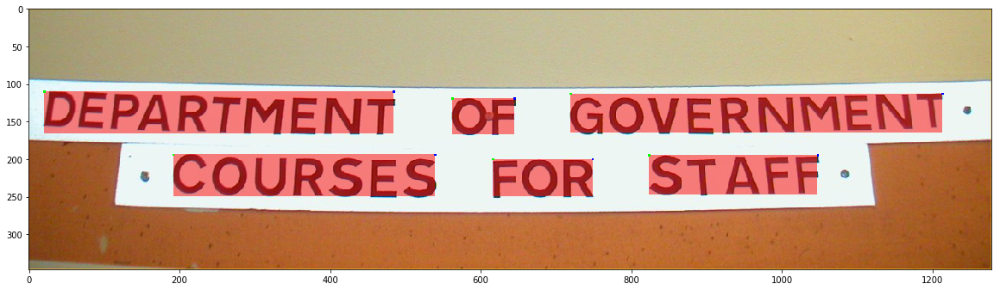

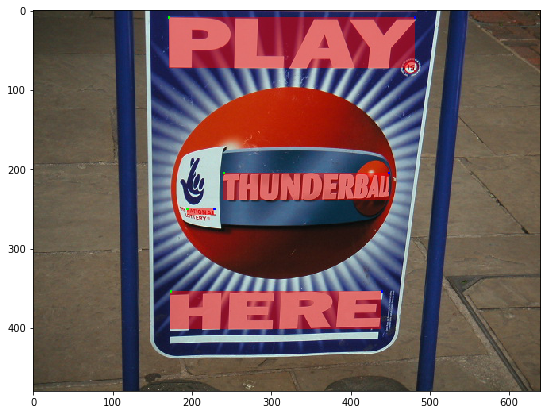

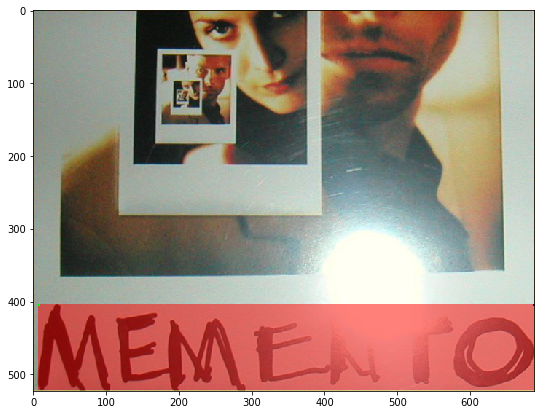

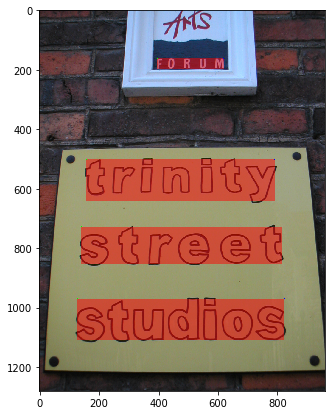

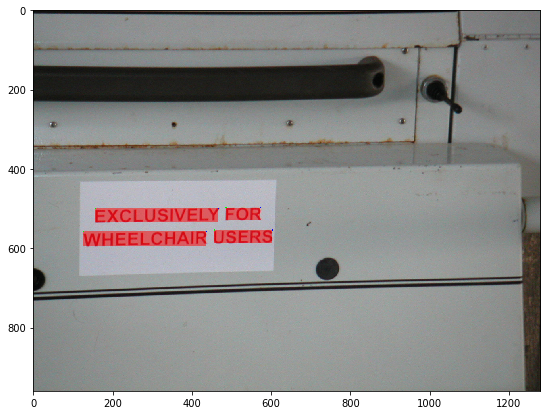

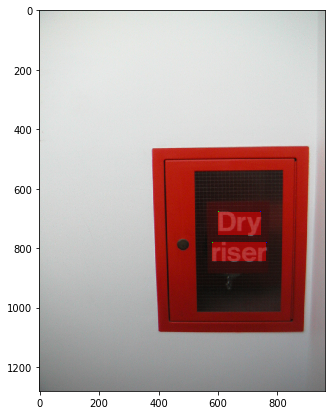

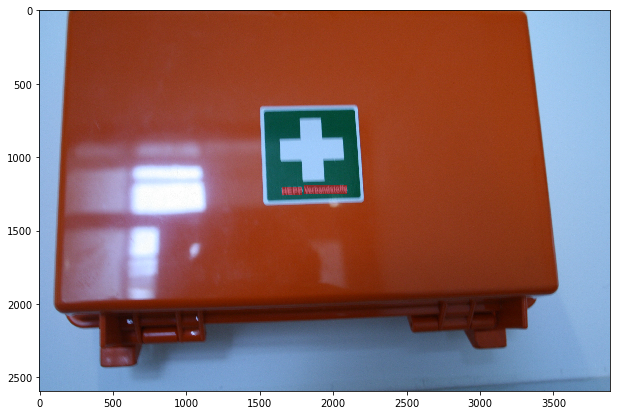

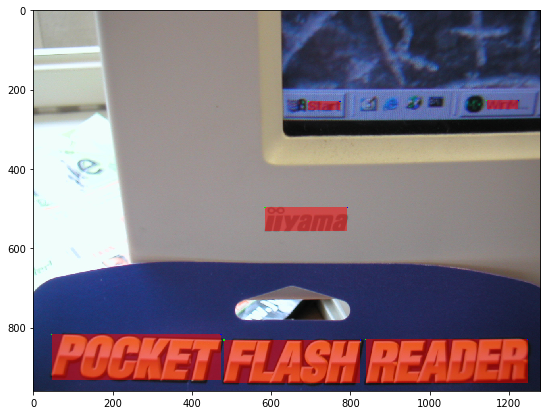

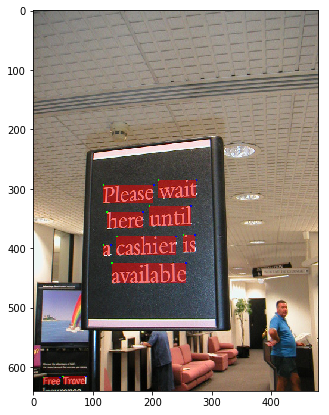

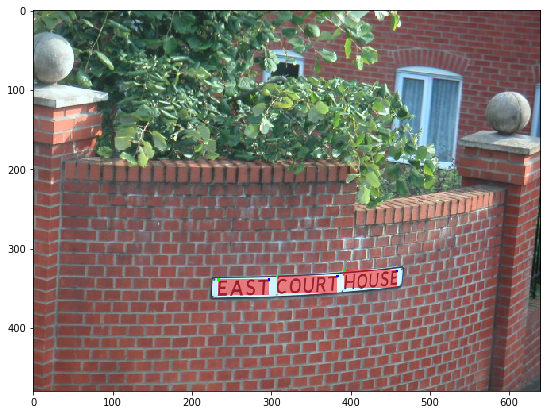

In [9]:
for fn in os.listdir(img_root)[:10]:
    gt_fn = 'gt_' + os.path.splitext(fn)[0] + '.txt'
    p_list = []
    with open(os.path.join(gt_root, gt_fn)) as f_gt:
        for line in f_gt.readlines():
            line = line.decode("utf-8-sig").encode("utf-8")
            items = line.strip().split(',')
            if len(items) < 5:
                items = line.strip().split(' ')
            xmin, ymin, xmax, ymax = [int(x) for x in items[:4]]
            xc = (xmin+xmax)/2
            yc = (ymin+ymax)/2
            w = xmax - xmin
            h = ymax - ymin
            p = rbox_2_polygon(xc, yc, w, h, 0)
            p_list.append(p)

    im = io.imread(os.path.join(img_root, fn))
    show_polygons(im, np.array(p_list, dtype=np.float32))

# MSRA-TD500

In [10]:
data_root = '/world/data-c7/censhusheng/data/MSRA-TD500/train'

-0.04804
([747.0294189453125, 861.6644897460938, 792.976318359375, 859.4555053710938, 797.9705810546875, 963.3355102539062, 752.023681640625, 965.5444946289062], 45.99996932319598, 103.9999907419368, 45.99996932319598, 103.9999907419368)
-0.023252
([727.4906616210938, 919.1919555664062, 743.486328125, 918.8199462890625, 744.5093383789062, 962.8080444335938, 728.513671875, 963.1800537109375], 15.999991806454721, 43.99999236764151, 15.999991806454721, 43.99999236764151)


/usr/lib/python2.7/site-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  # This is added back by InteractiveShellApp.init_path()
/usr/lib/python2.7/site-packages/ipykernel_launcher.py:12: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  if sys.path[0] == '':


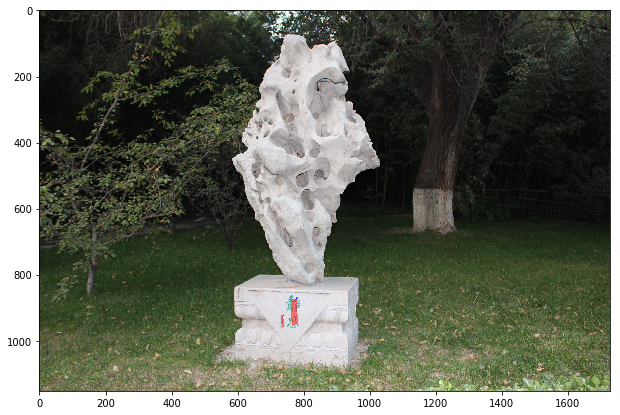

-0.205742
([886.0372314453125, 395.1138610839844, 1371.576416015625, 293.7842712402344, 1389.9627685546875, 381.8861389160156, 904.423583984375, 483.2157287597656], 495.99998541442176, 89.99998359806273, 495.99998541442176, 89.99998359806273)
-0.199908
([882.8748779296875, 533.7526245117188, 1359.1961669921875, 437.2431335449219, 1369.1251220703125, 486.24737548828125, 892.8038330078125, 582.7568359375], 486.000053766285, 49.99999877386725, 486.0000477061304, 49.99996886405125)
-0.180619
([1044.909423828125, 754.8710327148438, 1170.8271484375, 731.8772583007812, 1179.090576171875, 777.1289672851562, 1053.1728515625, 800.1227416992188], 127.99994934611185, 46.000015260082286, 127.99994934611185, 46.000015260082286)
-0.162562
([864.9202880859375, 950.7451782226562, 1308.9874267578125, 877.9140625, 1317.0797119140625, 927.2548217773438, 873.0125732421875, 1000.0859375], 449.99999451737017, 49.99995605112916, 449.99999451737017, 49.99995605112916)
-0.166609
([908.2570190429688, 1033.661010

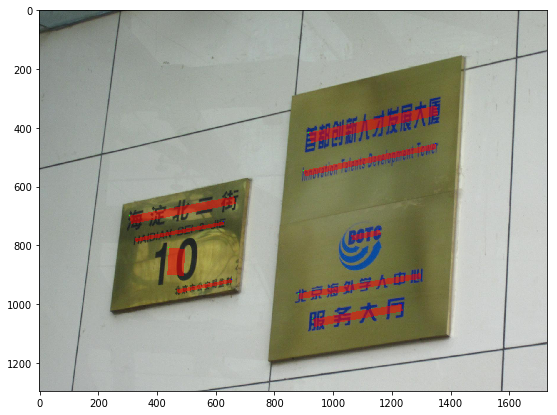

-0.105539
([346.4053955078125, 316.41070556640625, 821.7457885742188, 266.0566711425781, 830.5946044921875, 349.58929443359375, 355.25421142578125, 399.9433288574219], 478.00001889464573, 84.00000414898099, 478.00001889464573, 84.00000414898099)
-0.112264
([257.90838623046875, 448.2769470214844, 941.5774536132812, 371.20147705078125, 950.0916137695312, 446.7230529785156, 266.42254638671875, 523.7985229492188], 688.0000158192508, 75.99999574851846, 688.0000158192508, 75.99999574851846)
-0.125142
([434.49188232421875, 767.4485473632812, 906.76953125, 708.0363159179688, 914.5081176757812, 769.5514526367188, 442.23046875, 828.9636840820312], 475.9999904623685, 61.99998197899569, 475.9999904623685, 61.99998197899569)
-0.152649
([482.29449462890625, 950.388916015625, 1522.0615234375, 790.425048828125, 1532.70556640625, 859.611083984375, 492.93841552734375, 1019.574951171875], 1051.9999586516299, 70.00002222401402, 1052.0000793024772, 70.00000366238602)
-0.126767
([503.9129333496094, 1051.238

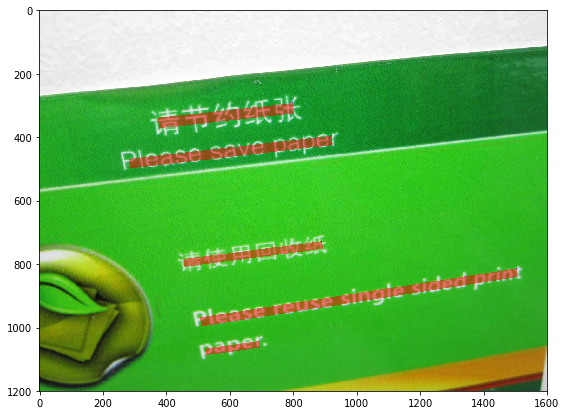

-0.565397
([562.5968627929688, 367.625, 709.518310546875, 274.404296875, 1112.403076171875, 909.375, 965.481689453125, 1002.595703125], 174.00003247477625, 751.9999522604826, 173.99998093815952, 751.9999849601335)


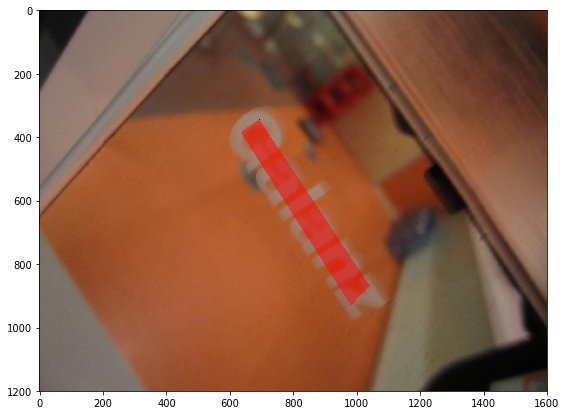

-0.043392
([780.0072021484375, 745.5791015625, 1517.3125, 713.5658569335938, 1523.9927978515625, 867.4208984375, 786.6875, 899.4341430664062], 737.9999661732048, 154.00000056998152, 737.9999661732048, 154.00000056998152)
-0.064101
([789.1405029296875, 923.097900390625, 1086.528564453125, 904.0089111328125, 1089.8594970703125, 955.902099609375, 792.4714965820312, 974.9910888671875], 298.00008162339947, 51.99998194580728, 298.00002071359467, 51.99998585553647)
-0.029753
([1168.7711181640625, 892.0097045898438, 1504.6224365234375, 882.01416015625, 1506.2288818359375, 935.9902954101562, 1170.3775634765625, 945.98583984375], 336.0000282027581, 54.00003558785896, 336.0000282027581, 54.00003558785896)


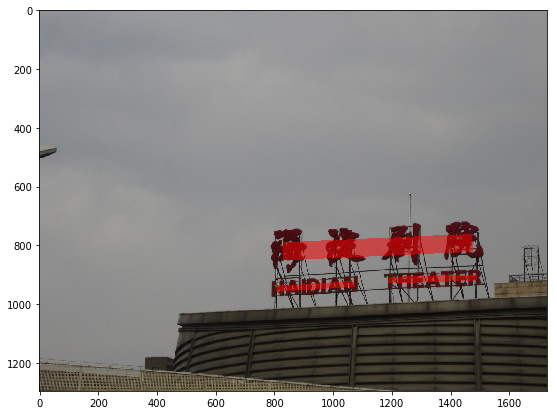

-0.511063
([169.7779541015625, 874.70751953125, 1401.35986328125, 184.0916748046875, 1542.2220458984375, 435.29248046875, 310.64013671875, 1125.9083251953125], 1412.0000864044123, 287.9999987117222, 1412.0000864044123, 287.9999987117222)


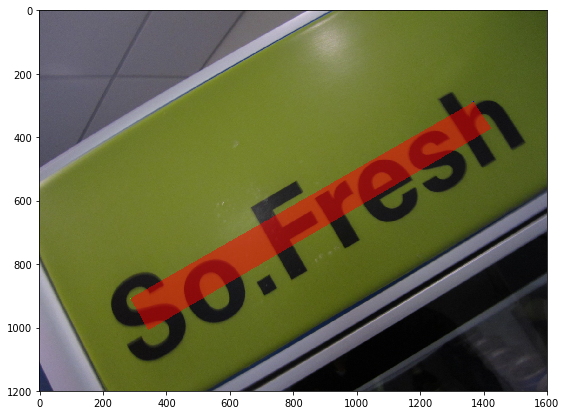

0.033742
([737.116943359375, 486.8006896972656, 986.9746704101562, 495.2345886230469, 984.883056640625, 557.1992797851562, 735.0253295898438, 548.765380859375], 250.00002883614434, 61.99998224980785, 250.00002883614434, 61.99998224980785)
0.147568
([687.8380126953125, 921.4063720703125, 1354.5126953125, 1020.506591796875, 1342.1619873046875, 1103.5936279296875, 675.4873046875, 1004.493408203125], 673.9999896087393, 83.99997358112402, 673.9999896087393, 83.99997358112402)


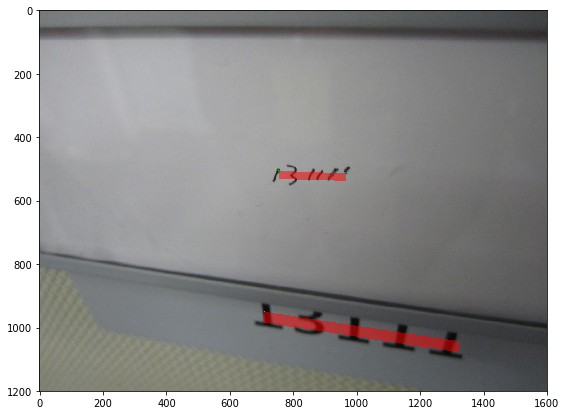

In [11]:
for fn in os.listdir(data_root)[:10]:
    if os.path.splitext(fn)[1] == '.gt':
        continue
    gt_fn = os.path.splitext(fn)[0] + '.gt'
    p_list = []
    with open(os.path.join(data_root, gt_fn)) as f_gt:
        for line in f_gt.readlines():
            #line = line.decode("utf-8-sig").encode("utf-8")
            items = line.strip().split()
            index = int(items[0])
            difficult = int(items[1])
            x = int(items[2])
            y = int(items[3])
            w = int(items[4])
            h = int(items[5])
            xc = x + 0.5*w
            yc = y + 0.5*h
            rad = float(items[6])
            print rad ###
            p = rbox_2_polygon(xc, yc, w, h, rad)
            p = shrink_quadrangle(p, 0.3)
            p_list.append(p)
    polygons = np.array(p_list, dtype=np.float32)
    im = io.imread(os.path.join(data_root, fn))
    show_polygons(im, polygons)    